## Problema?

Minha empresa está fazendo estudos sobre a viabilidade do trabalho parcial como modalidade a ser adotada por todas as suas equipes. Devido ao Covid, é importante minimizar o número de pessoas que vão frequentar a cede da empresa ao mesmo tempo. Sendo assim:

1. Qual deve ser o número de funcionários mínimo que a cede deve ser capaz de abrigar para que todas as equipes possam ir ao escritório ao menos uma vez?
2. Como agendar a ida das equipes a cede de forma a atingir esse mínimo?

## Modelagem do problema

O problema pode ser modelado como um Problema de Otimização discreta com restirções. Seja f(A) uma função que recebe uma agenda e devolve o número de lugares que a empresa deve fornecer aos funcionários para garantir o cumprimento da agenda. Agenda neste contexto é um calendário que, no formato matricial, $A_{i,j}$ que:

* Em cada linha tem os dias da semana
* Em cada coluna os times da empresa
* Uma entrada True, caso o time vá a empresa naquele dia e false em caso contrário

Sendo: $t$ um vetor que tem o número de membros de cada equipe da empresa e $N_min$ o número mínimo de didas que cda time deve comparecer ao escritório na semana.

Podemos modelar o problema como sendo:

\begin{equation}
A^* = arg min f(A) \text{, restrito à:} \\

At \geq N_{min}, \forall j \\
\end{equation}

## Solução usando Simulated Annealing (Método de Monte Carlo)

Na seção que segue, vamos resolver o problema usando o método de [Simulated Annealing](https://en.wikipedia.org/wiki/Simulated_annealing) para reslver o problema.

> Cuidado! Esse método é estocástico, e a solução ótima pode não ser realmente a solução obtida na primeira rodada. Embora isso seja pouco provável




In [2]:
import numpy as np
from scipy import optimize
import math
import matplotlib.pyplot as plt
from tqdm import tqdm
import pandas as pd

In [89]:
teams = np.array([5,10,11,5,3,8,4,4]).reshape(-1,1)
teams_names = ['DS', 'Gabriel', 'Bruno', 'Vicente', 'Roma', 'Mauro', 'Letícia', 'Cadu']
working_day = 5
number_of_teams = len(teams)
min_team_days_on_site = 2

print("dados do problema:")
print(f"N_min = {min_team_days_on_site}")
print(f"t = {teams.reshape(-1)}^t")

dados do problema:
N_min = 2
t = [ 5 10 11  5  3  8  4  4]^t


Inicializando variáveis

In [90]:
A = np.random.choice(a=[False, True], size=(working_day, number_of_teams))
f_hist = []

In [91]:
def get_number_spots(A):
    global teams
    spots = np.matmul(A,teams)

    teams_days_on_site = A.sum(axis=0)
    if any([i < min_team_days_on_site for i in teams_days_on_site]):
        return 2*sum(teams)[0].sum(axis=0)
        
    return max(spots)[0]

In [92]:
def simulated_annealing_min(T_hist, A):
    
    def generate_next_schedule(A):
        num_working_days, num_teams = A.shape
        
        i = np.random.randint(0, num_working_days)
        j = np.random.randint(0, num_teams)
        B = A.copy()

        B[i,j] = not A[i,j]
        return B
    
    f_eval = get_number_spots(A)
    f_hist = [f_eval]

    def accept_schedule(f_eval1, t):
        # print(t)
        # print(f"f_eval {f_eval} t {t}")
        # print(f"f_eval1 {f_eval1}")
        p_accept = min(1, math.exp((f_eval-f_eval1)/t))
        # print(f"prob accept {p_accept}")
        return np.random.uniform() <= p_accept
    
    for i,t in enumerate(T_hist):
        # print('proximo')
        A1 = generate_next_schedule(A)
        f_eval1 = get_number_spots(A1)
#         print(f"new f_eval {f_eval1}")
        if accept_schedule(f_eval1, t):
            f_hist.append(f_eval1)
            f_eval = f_eval1
            A = A1
            # print(A1)
        # if i % 100:
        #     print(f"fval: {f_eval}")
        #     print(A)
    
    return A, f_eval, f_hist
    

In [93]:
def linear_temperature():
    T_i = 10
    T_f = .01
    T_vet = np.linspace(T_i, T_f, 5000)
    T_out = np.array([])
    for t in T_vet:
        v = t*np.ones(100)
        T_out = np.concatenate((T_out, v))
    return T_out

In [94]:
T = linear_temperature()

In [95]:
A_opt, f_val, f_hist = simulated_annealing_min(T, A)

In [102]:
def plot_optmization(f_hist, T):
    
    def movingaverage(interval, window_size):
        window = np.ones(int(window_size))/float(window_size)
        return np.convolve(interval, window, 'same')
    
    plt.figure(figsize=(8, 6))
    plt.plot(f_hist, 'xb')
    plt.plot(movingaverage(f_hist,200), '-g')
    # plt.plot(T, '-r')
    plt.xlabel("iteração do método")
    plt.ylabel("Número de lugares na cede")
    plt.grid(True)
    plt.title("Trajetória de otimização")
    # plt.legend(["f_eval", "moving avarage", "temperatura"])
    plt.legend(["f_eval", "moving avarage"])
    plt.show()

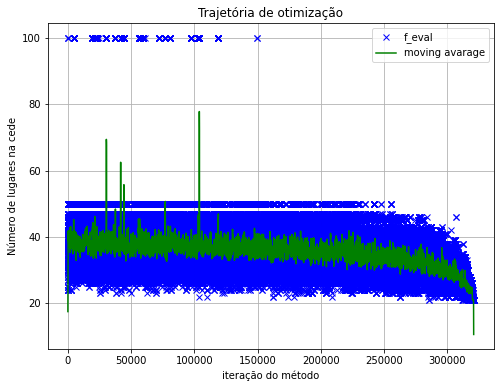

In [103]:
plot_optmization(f_hist, T)

## Interpretando resultados

Uma agenda é uma matriz que: nas colunas tem os dias na semana e nas linhas os times da Stone Age. As entradas da matriz são True nos dias em que o time vai ao escritório e False em caso contrário

In [104]:
schedule_df = pd.DataFrame(data=A_opt.transpose(), columns=['seg', 'ter', 'qua', 'qui', 'sex'], index=teams_names)
schedule_df

,seg,ter,qua,qui,sex
DS,False,True,False,True,False
Gabriel,False,False,True,False,True
Bruno,False,False,True,True,False
Vicente,True,False,False,True,False
Roma,True,False,False,False,True
Mauro,True,True,False,False,False
Letícia,True,False,False,False,True
Cadu,False,True,False,False,True


In [105]:
print(f"Número mínimo de lugares: {f_val}")

Número mínimo de lugares: 21
